In [2]:
# Cell 1 — Imports
import os
import io
import time
import json
import pickle
import requests
from io import StringIO

# Visualization
import plotly.express as px
from wordcloud import WordCloud, STOPWORDS

# Panel / hvplot
import panel as pn
pn.extension()
import param
import hvplot.pandas
import pandas as pd
import numpy as np

# API Secret
from lib.API_KEY import API_KEY


In [3]:
# Cell 2 — Local Audio File
audio_file = "audio.mp3"

print("Exists:", os.path.exists(audio_file))
if os.path.exists(audio_file):
    print("Size (bytes):", os.path.getsize(audio_file))
else:
    raise FileNotFoundError(f"{audio_file} not found. Place your audio file correctly.")


Exists: True
Size (bytes): 6235776


In [5]:
# Cell 3 — Upload to AssemblyAI
upload_url_endpoint = "https://api.assemblyai.com/v2/upload"
headers_upload = {"authorization": API_KEY}

def upload_file_to_assemblyai(filename):
    with open(filename, "rb") as f:
        resp = requests.post(upload_url_endpoint, headers=headers_upload, data=f)
    resp.raise_for_status()
    return resp.json()["upload_url"]

print("Uploading...")
uploaded_audio_url = upload_file_to_assemblyai(audio_file)
print("Uploaded URL:", uploaded_audio_url)


Uploading...
Uploaded URL: https://cdn.assemblyai.com/upload/1b736d2a-ea6e-49d4-9016-8c21b74ba63b


In [6]:
# Cell 4 — Submit transcription job
endpoint = "https://api.assemblyai.com/v2/transcript"
json_payload = {
    "audio_url": uploaded_audio_url,
    "auto_chapters": True,
    "sentiment_analysis": True,
    "auto_highlights": True,
    "iab_categories": True
}
headers_json = {"authorization": API_KEY, "content-type": "application/json"}

resp = requests.post(endpoint, json=json_payload, headers=headers_json)
resp.raise_for_status()
response_json = resp.json()
transcript_id = response_json["id"]

print("Transcript ID:", transcript_id)


Transcript ID: ece98ce2-99d2-497d-b7a5-8d7c93a6a6e0


In [8]:
# Cell 5 — Poll AssemblyAI for status
result_endpoint = f"{endpoint}/{transcript_id}"
headers_auth = {"authorization": API_KEY}

while True:
    r = requests.get(result_endpoint, headers=headers_auth).json()
    status = r.get("status")
    print("Status:", status)

    if status == "completed":
        print("Transcription Completed.")
        break

    if status == "error":
        raise RuntimeError("Transcription error:", r.get("error"))

    time.sleep(3)


Status: processing
Status: processing
Status: processing
Status: processing
Status: completed
Transcription Completed.


In [9]:
# Cell 6 — Save transcript
final_result = requests.get(result_endpoint, headers=headers_auth).json()

with open("transcript.json", "w", encoding="utf-8") as f:
    json.dump(final_result, f, ensure_ascii=False, indent=2)

with open("transcript.txt", "w", encoding="utf-8") as f:
    f.write(final_result.get("text", ""))

with open("speech_data.pkl", "wb") as f:
    pickle.dump(final_result.copy(), f)

print("Saved transcript.json, transcript.txt, speech_data.pkl")


Saved transcript.json, transcript.txt, speech_data.pkl


In [10]:
# Cell 7 — Quick preview
transcript_text = final_result.get("text", "")
print("Text preview:\n", transcript_text[:500])
print("Chapters:", final_result.get("chapters"))
print("Highlights sample:", final_result.get("auto_highlights_result"))
print("Sentiment sample:", final_result.get("sentiment_analysis_results")[:3])


Text preview:
 Thank you, Mr. Secretary General, UNICEF Executive Director, and all the excellencies and distinguished guests from across the world. My name is Kim Namjoon, also known as rm, the leader of the group bts. It is an incredible honor to be invited to an occasion with such significance for today's young generation. Last November, BTS launched the Love My Symph campaign with unicef. Building on our belief that true love first begins with loving myself, we've been partnering with UNICEF's End Violence
Chapters: [{'summary': "Last November, BTS launched the Love My Symph campaign with unicef. Building on our belief that true love first begins with loving myself, we've been partnering with UNICEF's End Violence Program. And our fans have become a major part of this campaign. With their action and with their enthusiasm, we truly have the best fans in the world.", 'headline': 'BTS partnered with UNICEF to launch Love My Symph campaign', 'gist': 'BTS', 'start': 1760, 'end': 49450},

In [11]:
# Cell 8 — Load saved data
with open(audio_file, "rb") as f:
    audio_bytes = io.BytesIO(f.read())

with open("speech_data.pkl", "rb") as f:
    data = pickle.load(f)


In [12]:
# Cell 9 — Audio + Download
buffer = StringIO()
buffer.write(data.get("text", ""))
buffer.seek(0)

transcript_download = pn.widgets.FileDownload(file=buffer, filename="transcript.txt", button_type="success")
audio_play = pn.pane.Audio(audio_bytes, name="Audio", autoplay=False)

pn.Row(transcript_download, audio_play)


Row
    [0] FileDownload(button_type='success', file=<_io.StringIO o..., filename='transcript.txt', label='Download transcript.txt')
    [1] Audio(BytesIO)

In [13]:
# Cell 10 — Sentiment DataFrame + Bar Plot
sentiment = data.get("sentiment_analysis_results", [])
sentiment_df = pd.DataFrame(sentiment)

sentiment_counts = sentiment_df["sentiment"].value_counts() if not sentiment_df.empty else pd.Series()

if not sentiment_counts.empty:
    sentiment_plot = sentiment_counts.hvplot.bar(title="Sentences by Sentiment")
else:
    sentiment_plot = pn.pane.Markdown("No sentiment data available.")

positive_df = sentiment_df[sentiment_df["sentiment"] == "POSITIVE"]
negative_df = sentiment_df[sentiment_df["sentiment"] == "NEGATIVE"]
neutral_df  = sentiment_df[sentiment_df["sentiment"] == "NEUTRAL"]

sentiment_tabs = pn.Tabs(
    ("Overview", sentiment_plot),
    ("Positive", pn.widgets.DataFrame(positive_df, width=700, height=300)),
    ("Negative", pn.widgets.DataFrame(negative_df, width=700, height=300)),
    ("Neutral",  pn.widgets.DataFrame(neutral_df, width=700, height=300))
)

sentiment_tabs


Tabs
    [0] HoloViews(Bars, height=300, name='Overview', sizing_mode='fixed', width=700)
    [1] DataFrame(height=300, sizing_mode='fixed', value=   sentiment              ..., width=700)
    [2] DataFrame(height=300, sizing_mode='fixed', value=   sentiment              ..., width=700)
    [3] DataFrame(height=300, sizing_mode='fixed', value=   sentiment              ..., width=700)

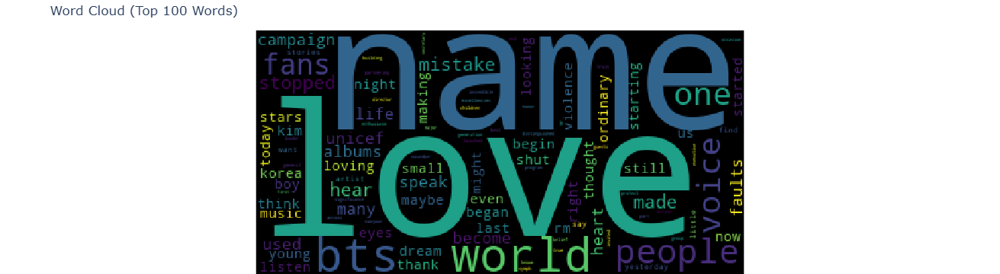

In [14]:
# Cell 11 — Word Cloud Slider
text = data.get("text", "")
if not text:
    text = "No transcript available."

# Process words
stopwords = set(STOPWORDS)
words = [w.lower() for w in text.split()]
all_words = " ".join(words)

# Generate word cloud
wc = WordCloud(
    background_color="black",
    stopwords=stopwords,
    max_words=100,
    collocations=False
).generate(all_words)

# Plot using Plotly
fig = px.imshow(wc)
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.update_layout(
    title="Word Cloud (Top 100 Words)",
    margin=dict(l=0, r=0, t=40, b=0)
)

fig.show()


In [16]:
# Cell 12 — Chapter summary + audio jumping
chapters = data.get("chapters", [])
chapters_layout = pn.Column("### Auto Chapter Summary")

class ButtonAudio:
    def __init__(self, start):
        self.start = start
        self.button = pn.widgets.Button(name=f"{start/1000:.0f}s", button_type="primary", width=60)
        self.audio = pn.pane.Audio(io.BytesIO(audio_bytes.getvalue()), time=start/1000)
        self.button.on_click(self.jump)

    def jump(self, event):
        self.audio.time = self.start / 1000

for ch in chapters:
    widget = pn.widgets.StaticText(value=ch.get("summary", ""), width=1000)
    btn = ButtonAudio(ch.get("start"))
    chapters_layout.append(pn.Row(btn.button, btn.audio, widget))

chapters_layout


Column
    [0] Markdown(str)
    [1] Row
        [0] Button(button_type='primary', name='2s', width=60)
        [1] Audio(BytesIO, time=1.76)
        [2] StaticText(value="Last November, ..., width=1000)
    [2] Row
        [0] Button(button_type='primary', name='52s', width=60)
        [1] Audio(BytesIO, time=52.34)
        [2] StaticText(value='Kim Nam Joon: It took me ..., width=1000)

In [17]:
# Restore transcript text
text = data.get("text", "")

print("Transcript length:", len(text))


Transcript length: 4146


In [18]:
import nltk
nltk.download("stopwords")


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ASAITHAMBI\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

Filtered word count: 350


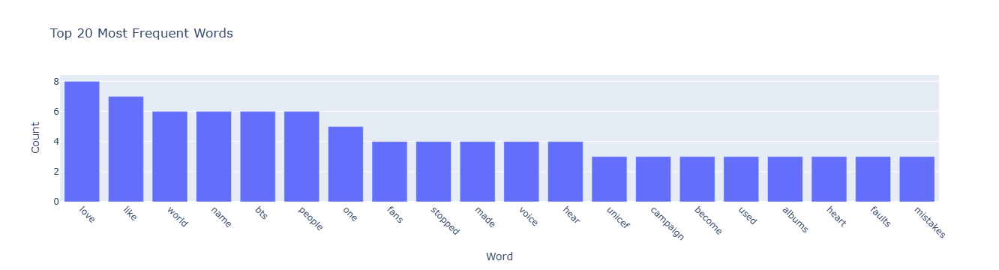

In [19]:
# ---- WORD FREQUENCY BAR CHART ----
import pandas as pd
from collections import Counter
import plotly.express as px
import re
from nltk.corpus import stopwords

if not text:
    raise ValueError("❌ ERROR: `text` is empty. Reload your transcript first.")

# Clean transcript text
clean_text = re.sub(r"[^a-zA-Z ]", " ", text.lower())
words = clean_text.split()

# Remove stopwords
stop = set(stopwords.words("english"))
filtered_words = [w for w in words if w not in stop and len(w) > 2]

print("Filtered word count:", len(filtered_words))

# Count top 20 frequent words
word_counts = Counter(filtered_words).most_common(20)
df_wc = pd.DataFrame(word_counts, columns=["word", "frequency"])

# Plot
fig = px.bar(
    df_wc,
    x="word",
    y="frequency",
    title="Top 20 Most Frequent Words",
    labels={"word": "Word", "frequency": "Count"}
)

fig.update_layout(xaxis_tickangle=45)
fig.show()
